# Homework 3

Michael Anderson

manderson113@student.gsu.edu

002485269

In [1]:
import pandas as pd
import numpy as np
import pandas_profiling
import matplotlib.pyplot as plt
from sklearn import preprocessing
import matplotlib.pyplot as plt
%matplotlib inline

## 1

A Bernoulli trial is a random experiment with two distinct outcomes. A bernoulli trial will have a probability P where $P = \frac{\textrm{outcomes of interest}}{\textrm{all possible outcomes}}$. the odds of an outcome can be expressed as $odds = (\frac{P(\textrm{occuring})}{P(\textrm{not occuring})}$. The odds ratio between two outcomes can be expressed as $\textrm{odds ratio of }p_{1}:p_{0} = \frac{odds(p_{1})}{odds(p_{0})}$.

This odds ratio is useful for logistic regression, because it represents how the odds change as one variable changes while holding all other variables constant.

We can map the lienar combination of variables to a result with a domain from 0 to 1 with the logit (natural log of the odds).

$ln(\textrm{odds}) \Longrightarrow ln(\frac{p}{1-p}) \Longrightarrow \textrm{logit}(p)$

To convert this into a graph with a *range* of $(0,1)$, we must graph it's inverse.

$\textrm{logit}^{-1}(a)=\frac{1}{1+e^{-a}}=\frac{e^{a}}{1+e^{a}}$

This gives us a nice sigmoid function "S" curve.

We can equate this to a linear function of the independent variables like so:

$ln(\frac{p}{1-p}) = \beta_{0} + \beta_{1}x_{1} \underset{\textrm{antilog}}{\Longrightarrow} \frac{p}{1-p}=e^{\beta_{0} + \beta_{1}x_{1}} \Longrightarrow \hat{p}=\frac{e^{\beta_{0} + \beta_{1}x_{1}}}{1 + e^{\beta_{0} + \beta_{1}x_{1}}}$

When training to identify a result of 3 or more distinct classifications, there is no way to express this with numbers. Reordering the classifications would change the outcome, and it implies that there is and identical difference between adjacent classifications, which has no basis in reality. Linear regression simply can't be used for qualitative responses that can't be converted into a quantitative response, which includes all qualitative response variables with three or more levels. Even classifying two-level qualitative responses, linear regression can be a poor method compared to logistic regression when the response does not resemble a linear relationship, as below.

## 2

For statistical classification, we can visualize the effectiveness of an algorithm by using a Confusion Matrix.

| | Predicted: No | Predicted: Yes |
| :-: | :-: | :-: |
| **Actual: No** | True Negative | False Positive |
| **Actual: Yes** | False Negative | True Positive |

### Precision

$ \textrm{Precision} = \frac{\textrm{True Positive}}{\textrm{True Positive + False Positive}} $

Precision only considers the cases where the prediction is true. For the above matrix, only the rightmost column is considered.

### Recall

$ \textrm{Recall} = \frac{\textrm{True Positive}}{\textrm{True Positive + False Negative}} $

Recall only considers the cases where the actual result was true, only the "relevant" data. For the above matrix, only the bottom row is considered.

## 3

In [2]:
heart = pd.read_csv("data/heart.csv")
heart.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Based on the Correlation table, these values have the most correlation to the target:

#### cp, thalach, exang, oldpeak, slope, ca

In [3]:
from sklearn.linear_model import LogisticRegression

In [4]:
train=heart.sample(frac = 0.7)
test=heart.drop(train.index)

In [5]:
all_features=['age', 'sex', 'cp', 'trestbps', 'chol', 'fbs', 'restecg', 'thalach',
       'exang', 'oldpeak', 'slope', 'ca', 'thal']
predictors_or_features=['cp','thalach','exang','oldpeak','slope']
predictors_or_features=['cp']
x_train=train[list(predictors_or_features)].values
y_train=train['target'].values
model=LogisticRegression()
model.fit(x_train,y_train)

LogisticRegression()

In [6]:
x_test=test[list(predictors_or_features)].values
y_test=train['target'].values
predicted=model.predict(x_train)

In [7]:
from sklearn import metrics
cm = metrics.confusion_matrix(y_test, predicted)
print(cm)

[[79 22]
 [26 85]]


In [8]:
tp = cm[1][1]
tn = cm[0][0]
fp = cm[1][0]
fn = cm[0][1]

In [9]:
analysis = {}
analysis["true_positive"] = tp
analysis["true_negative"] = tn
analysis["false_positive"] = fp
analysis["false_negative"] = fn
analysis["accuracy"] = (tp+tn)/(tp+tn+fp+fn)
analysis["missclassification"] = 1 - analysis["accuracy"]
analysis["sensitivity"] = tp/(tp+fn)
analysis["specificity"] = tn/(tn+fp)
analysis["positive_prediction_value"] = tp/(tp+fp)
analysis["negative_prediction_value"] = tn/(tn+fn)
analysis["positive_likelihood_ratio"] = analysis["sensitivity"]/(1-analysis["specificity"])
analysis["negative_likelihood_ratio"] = 1/analysis["positive_likelihood_ratio"]
length = max(len(key) for key in analysis) + 1
for key, val in analysis.items():
    name = f"{key.replace('_',' ').title()}:"
    print(f"{name: <{length}} {val}")

True Positive:             85
True Negative:             79
False Positive:            26
False Negative:            22
Accuracy:                  0.7735849056603774
Missclassification:        0.2264150943396226
Sensitivity:               0.794392523364486
Specificity:               0.7523809523809524
Positive Prediction Value: 0.7657657657657657
Negative Prediction Value: 0.7821782178217822
Positive Likelihood Ratio: 3.2081236520488856
Negative Likelihood Ratio: 0.31170868347338937


## 4

In [10]:
myopia = pd.read_csv("data/MYOPIA.csv")
spherical_equivalent_refraction = myopia['SPHEQ']
spherical_equivalent_refraction.head()
ser_min = spherical_equivalent_refraction.min()
ser_max = spherical_equivalent_refraction.max()
print(f"{ser_min} <= SER <= {ser_max}")

-0.699000001 <= SER <= 4.372000217


In [11]:
myopia.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### a

$\frac{p}{1-p}=e^{\alpha}$

$\alpha = \beta_{0} + \beta_{1}x_{1}$

$\beta_{0} = \textrm{intercept}$

$\beta_{1} = \textrm{coefficient for SPHEQ on MYPOIC}$

$x_{1} = \textrm{value of SPHEQ}$

### b

$\textrm{logit}(p) = \textrm{ln}(\frac{p}{1-p}) = \beta_{0} + \beta_{1}x_{1}$

$\hat{p}_{\textrm{myopic}}=\frac{e^{\alpha}}{1 + e^{\alpha}}$

$\textrm{logit}^{-1} = \frac{1}{1+e^{-\alpha}} = \frac{e^{\alpha}}{1 + e^{\alpha}}$

We want to use Logistic Regression instead of Linear Regression to describe this relationship, because it is a binary qualitative response. There is no linear representation of such a relationship.

### c

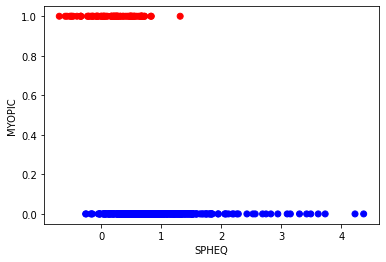

In [12]:
x = myopia['SPHEQ']
y = myopia['MYOPIC']

plt.scatter(x, y, c=y, cmap='bwr')

plt.xlabel("SPHEQ")
plt.ylabel("MYOPIC")

plt.show()

### d

In [13]:
# import libraries
import numpy as np, pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns
from scipy.optimize import minimize
import scipy.stats as stats
import pymc3 as pm3
import numdifftools as ndt
import statsmodels.api as sm
from statsmodels.base.model import GenericLikelihoodModel
import statsmodels.formula.api as smf
%matplotlib inline

WARNING (theano.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


In [14]:
x = myopia['SPHEQ']
exog = sm.add_constant(x, prepend=True)
endog = myopia['MYOPIC']

In [15]:
class MyProbit(GenericLikelihoodModel):
    def loglike(self, params):
        exog = self.exog
        endog = self.endog
        q = 2 * endog - 1
        return stats.norm.logcdf(q*np.dot(exog, params)).sum()

In [16]:
sm_probit_manual = MyProbit(endog, exog).fit()
print(sm_probit_manual.summary())
print(sm_probit_manual.params)

Optimization terminated successfully.
         Current function value: 0.273000
         Iterations: 51
         Function evaluations: 98
                               MyProbit Results                               
Dep. Variable:                 MYOPIC   Log-Likelihood:                -168.71
Model:                       MyProbit   AIC:                             341.4
Method:            Maximum Likelihood   BIC:                             350.3
Date:                Sun, 31 Oct 2021                                         
Time:                        23:13:07                                         
No. Observations:                 618                                         
Df Residuals:                     616                                         
Df Model:                           1                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------

In [17]:
b0 = sm_probit_manual.params[0]
b1 = sm_probit_manual.params[1]

In [18]:
from IPython.display import Markdown as md
md("$alpha = %.4f + %.4fx_{i}$"%(b0, b1))

$alpha = 0.0011 + -2.1080x_{i}$

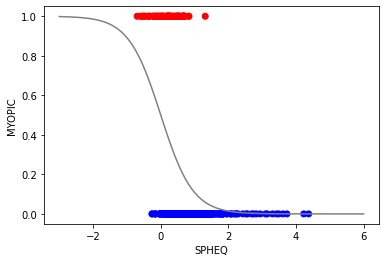

In [19]:
xs = np.linspace(-3,6,100)
alpha = np.exp(xs*b1 + b0)
ys = 1/(1+alpha**-1)
plt.plot(xs, ys, color='grey')
plt.scatter(myopia['SPHEQ'], myopia['MYOPIC'], c=myopia['MYOPIC'], cmap='bwr')
plt.xlabel("SPHEQ")
plt.ylabel("MYOPIC")
plt.show()

## 5

In [20]:
icu = pd.read_csv("data/icu.csv")

This data set consists of a sample of 200 subjects who were part of a much larger study on survival of patients following admission to an adult intensive care unit (ICU). The major goal of this study was to develop a logistic regression model to predict the probability of survival to hospital discharge of these patients. A number of the publications have appeared which have focused on various facets of this problem.

In [21]:
icu.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### a

$\frac{p}{1-p}=e^{\alpha}$

$\alpha = \beta_{0} + \beta_{1}x_{1}$

$\beta_{0} = \textrm{intercept}$

$\beta_{1} = \textrm{coefficient for AGE on STA}$

$x_{1} = \textrm{value of AGE}$

$\textrm{logit}(p) = \textrm{ln}(\frac{p}{1-p}) = \beta_{0} + \beta_{1}x_{1}$

$\hat{p}_{\textrm{myopic}}=\frac{e^{\alpha}}{1 + e^{\alpha}}$

$\textrm{logit}^{-1} = \frac{1}{1+e^{-\alpha}} = \frac{e^{\alpha}}{1 + e^{\alpha}}$

There is a lot of overlap of values, and no way to draw a straight line to describe the data.

### b

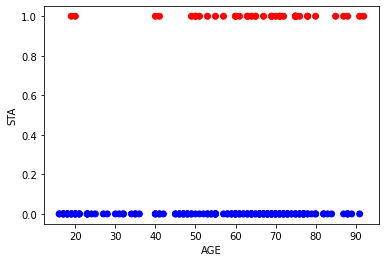

In [22]:
x = icu['AGE']
y = icu['STA']

plt.scatter(x, y, c=y, cmap='bwr')

plt.xlabel("AGE")
plt.ylabel("STA")

plt.show()

### c

Y = STA

X = AGE

likelihood: $\ell(\beta_{0},\beta_{1}) = \underset{i=1}{\overset{n}{\prod}}P(Y=y_{i}|X=x_{i}) = \underset{i:y_{i}=1}{\prod}p(x_{i}) * \underset{i':y_{i'}=0}{\prod}(1-p(x_{i'}))$

log-likelihood: $\underset{i=1}{\overset{n}{\sum}}\ln{(P(Y=y_{i}|X=x_{i}))} = \underset{i:y_{i}=1}{\sum}\ln{(p(x_{i}))} + \underset{i':y_{i'}=0}{\sum}\ln{(1-p(x_{i'}))}$

### d

In [23]:
from sklearn.model_selection import train_test_split
train_x, test_x, train_y, test_y = train_test_split(icu[['AGE']],icu['STA'],train_size=0.25)

In [24]:
model=LogisticRegression()
model.fit(train_x,train_y)

LogisticRegression()

In [41]:
probabilities = model.predict_proba(test_x)

In [39]:
prediction = model.predict(test_x)

In [40]:
from sklearn import metrics
metrics.accuracy_score(prediction,test_y)

0.7933333333333333

In [29]:
predicted_y = model.predict(test_x)
metrics.confusion_matrix(test_y,predicted_y)

array([[119,   0],
       [ 31,   0]])

*obtain expressions for the two likelihood equations*

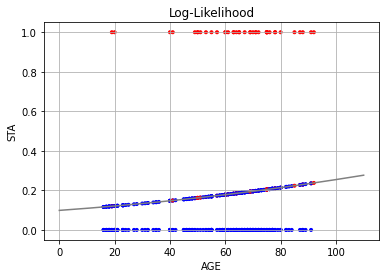

In [30]:
import scipy.stats

x = np.linspace(0, 110, 1000, endpoint=True)

data = icu["AGE"]

y = 1/(1+np.exp(-(model.coef_[0]*x + model.intercept_)))

fitted_x = icu['AGE']
fitted_y = 1/(1+np.exp(-(model.coef_[0]*fitted_x + model.intercept_)))
    
plt.scatter(icu['AGE'], icu['STA'],c=icu['STA'],cmap='bwr', marker='.')
plt.scatter(fitted_x, fitted_y, c=icu['STA'], cmap='bwr', marker='.')
plt.plot(x,y,color='grey')

plt.title(r'Log-Likelihood')
plt.xlabel("AGE")
plt.ylabel("STA")

plt.grid()
plt.show()

#### zooming out

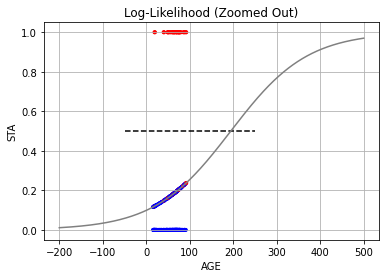

In [33]:
x = np.linspace(-200, 500, 1000, endpoint=True)

y = 1/(1+np.exp(-(model.coef_[0]*x + model.intercept_)))

plt.scatter(icu['AGE'], icu['STA'],c=icu['STA'],cmap='bwr', marker='.')
plt.scatter(fitted_x, fitted_y, c=icu['STA'], cmap='bwr', marker='.')
plt.plot(x,y, color='grey')
plt.hlines(0.5, -50, 250, colors=['black'], linestyles='dashed')

plt.title(r'Log-Likelihood (Zoomed Out)')
plt.xlabel("AGE")
plt.ylabel("STA")

plt.grid()
plt.show()

### e

For this data set, age is a poor predictor of STA. While it does increase the likelihood of STA, this did not create a useful model.